# Exploratory Data Analysis of Porthole Data

Methodology used:
1. Load Data
2. Describe Data
3. Clean Data (checking nulls, duplicates)
4. Perform preliminary Analysis
5. Present and Plot the insights

In [1]:
# import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px


df = pd.read_csv("../Data/Street_Pothole_Work_Orders_-_Closed__Dataset_.csv") #importing dataset
df.head(100)

,the_geom,DefNum,InitBy,HouseNum,OFT,OnFaceName,OnPrimName,FrmPrimNam,ToPrimName,SpecLoc,Boro,Source,RptDate,RptClosed,Shape_Leng
0,MULTILINESTRING ((-73.88643460204372 40.630776...,DB2004041154,YRD,NaN,373480377030377030,ROCKAWAY PY,ROCKAWAY PARKWAY,BELT PARKWAY,BELT PARKWAY,NaN,B,YRD,02/08/2004,01/27/2023,557.690465
1,MULTILINESTRING ((-73.94380842208851 40.584992...,DB2004287021,CSC,NaN,318630377030377030,BEDFORD AV,BEDFORD AVENUE,BELT PARKWAY,BELT PARKWAY,SB ON BEDFORD_UNDERNEATH OVERPASS,B,CTZ,10/13/2004,02/14/2013,109.124234
2,MULTILINESTRING ((-73.98570910180842 40.641185...,DB2006085009,CSC,NaN,306380308480308530,13 AV,13 AVENUE,38 STREET,39 STREET,I/F/O B16 BUS STOP,B,CTZ,03/26/2006,10/11/2014,260.495098
3,MULTILINESTRING ((-73.93487210852416 40.679593...,DB2007166005,CSC,1688,342730355530375430,FULTON ST,FULTON STREET,LEWIS AVENUE,SCHENECTADY AVENUE,POTHOLE NEAR CURB I/F/O ADDRESS,B,CTZ,06/15/2007,01/14/2011,549.255973
4,MULTILINESTRING ((-73.97793940872546 40.689806...,DB2009352004,CSC,45,380030331530342730,ST FELIX ST,ST FELIX STREET,DEKALB AVENUE,FULTON STREET,"4"" DEEP",B,CTZ,12/18/2009,01/06/2010,836.436669
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,MULTILINESTRING ((-73.97299434062448 40.608814...,DB2010006027,CSC,NaN,314380334880359430,AV P,AVENUE P,EAST 2 STREET,MCDONALD AVENUE,MULTIPLE POTHOLES ON THE ODD SIDE OF THE STREET,B,CTZ,01/06/2010,01/09/2010,302.904307
96,MULTILINESTRING ((-73.97618051298797 40.678064...,DB2010006028,CSC,146,305680380330381430,6 AV,6 AVENUE,ST JOHNS PLACE,STERLING PLACE,POTHOLE ON CORNER OF ST JOHN AND STERLING/SW C...,B,CTZ,01/06/2010,01/07/2010,260.545957
97,MULTILINESTRING ((-73.92491871761881 40.627983...,DB2010006029,CSC,NaN,341030314080337130,FLATLANDS AV,FLATLANDS AVENUE,AVENUE J,EAST 53 STREET,NaN,B,CTZ,01/04/2010,01/05/2010,226.471906
98,MULTILINESTRING ((-73.92041799881456 40.630904...,DB2010006030,CSC,NaN,341030314030337430,FLATLANDS AV,FLATLANDS AVENUE,AVENUE I,EAST 59 STREET,NaN,B,CTZ,01/04/2010,01/05/2010,318.833168


In [2]:
df.shape

(360730, 15)

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 360730 entries, 0 to 360729
Data columns (total 15 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   the_geom    360730 non-null  object 
 1   DefNum      360730 non-null  object 
 2   InitBy      360730 non-null  object 
 3   HouseNum    236000 non-null  object 
 4   OFT         360730 non-null  int64  
 5   OnFaceName  360067 non-null  object 
 6   OnPrimName  360653 non-null  object 
 7   FrmPrimNam  360700 non-null  object 
 8   ToPrimName  360624 non-null  object 
 9   SpecLoc     120304 non-null  object 
 10  Boro        360730 non-null  object 
 11  Source      360730 non-null  object 
 12  RptDate     360730 non-null  object 
 13  RptClosed   360730 non-null  object 
 14  Shape_Leng  360730 non-null  float64
dtypes: float64(1), int64(1), object(13)
memory usage: 41.3+ MB


We have 360730 rows and 15 columns in this data. Out of 15 Features, we have 13 objects, 1 Float and 1 Int.

## Data Cleaning

In [4]:
# checking nulls in the dataset

total_null_count = df.isnull().sum()
print(total_null_count)

the_geom           0
DefNum             0
InitBy             0
HouseNum      124730
OFT                0
OnFaceName       663
OnPrimName        77
FrmPrimNam        30
ToPrimName       106
SpecLoc       240426
Boro               0
Source             0
RptDate            0
RptClosed          0
Shape_Leng         0
dtype: int64


We have few nulls in the data but mostly in House_num and specific location and it is not going to help much with predicting because they have around 30% and 60% nulls respectively. As we already have the other columns "OFT	OnFaceName	OnPrimName	FrmPrimNam	ToPrimName	" so I am going to drop columns "House_num" and 'SpecLoc'.

In [5]:
df = df.drop(['HouseNum', 'SpecLoc'], axis=1) 

"OnFaceName" column is similar to "OnPrimName". They are basically same locations of the pothole so I am replacing null values of "OnFaceName" with "OnPrimName" 

In [6]:
df['OnFaceName'].fillna(df['OnPrimName'], inplace=True) #filling null values of "OnFaceName"
onFaceName_null_count = df['OnFaceName'].isnull().sum()
print(onFaceName_null_count)

77


We still have 77 null values in columns "OnFaceName" and "OnPrimName" , 30 nulls in 'FrmPrimNam' and 106 nulls in 'ToPrimName'. These are all unique address of the pothole occurence. I can't perform aggregation or impute these values So I have to drop them. This will not have a significant impact on our analysis as our dataset is quite large.

In [7]:
df = df.dropna(subset=['OnFaceName', 'OnPrimName', 'FrmPrimNam', 'ToPrimName'])
print(total_null_count)

the_geom           0
DefNum             0
InitBy             0
HouseNum      124730
OFT                0
OnFaceName       663
OnPrimName        77
FrmPrimNam        30
ToPrimName       106
SpecLoc       240426
Boro               0
Source             0
RptDate            0
RptClosed          0
Shape_Leng         0
dtype: int64


In [8]:
# convert datetime object to datetime data type
df['RptDate'] = df['RptDate'].astype('datetime64[ns]')  
df['RptClosed'] = df['RptClosed'].astype('datetime64[ns]')

date_threshold = pd.to_datetime('2009-12-31')

df = df[df['RptDate'] > date_threshold]

# The Data is starting from year 2004 whereas there are only 1 report per year for potholes between year 2004 and 2008. There are only 30 reports for year 2009. 
# So I am filtering the data and starting from year 2010 to remove any bias and to have real-time insights

In [15]:
df['index'] = range(0, len(df))
 # resetting the index as we it will be difficult to interpret the data without a numeric index, we already have "DefNum" but it is hard to interpret easily as it have string syntax

## Gathering Inisghts

In [14]:
df.head()

,the_geom,DefNum,InitBy,OFT,OnFaceName,OnPrimName,FrmPrimNam,ToPrimName,Boro,Source,RptDate,RptClosed,Shape_Leng,index
11,MULTILINESTRING ((-73.92993757815543 40.597146...,DB2010002001,CSC,343910312370314730,GERRITSEN AV,GERRITSEN AVENUE,ALLEN AVENUE,AVENUE W,B,CTZ,2010-01-02,2010-01-05,82.707368,0
12,MULTILINESTRING ((-73.9393340798436 40.6227256...,DB2010002004,CSC,336480314180354050,E 37 ST,EAST 37 STREET,AVENUE L,KINGS HIGHWAY,B,CTZ,2010-01-02,2010-01-05,426.877885,1
13,MULTILINESTRING ((-73.96733404030275 40.581517...,DB2010003002,CSC,392230367730390730,W AV,WEST AVENUE,OCEAN PARKWAY,WEST 5 STREET,B,CTZ,2010-01-03,2010-01-05,1071.289104,2
14,MULTILINESTRING ((-73.95866587485429 40.712797...,DB2010003004,CSC,373650378130378230,ROEBLING ST,ROEBLING STREET,SOUTH 1 STREET,SOUTH 2 STREET,B,CTZ,2010-01-03,2010-01-08,254.973102,3
15,MULTILINESTRING ((-73.98873129769669 40.593001...,DB2010003005,CSC,307730315780347730,26 AV,26 AVENUE,BATH AVENUE,HARWAY AVENUE,B,CTZ,2010-01-03,2010-01-05,729.958297,4


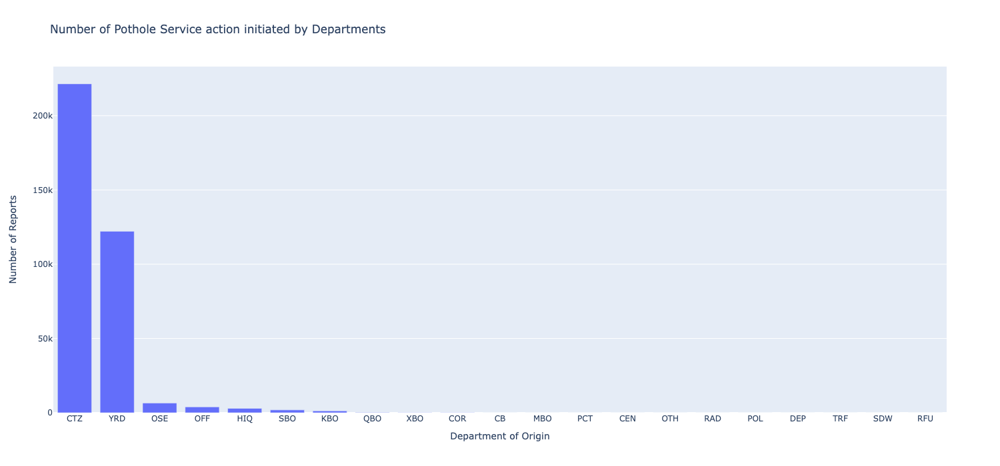

In [76]:
# Plotting the number of reports init

value_counts_Source = df['Source'].value_counts().reset_index() # storing count of values in a variable of "InitBy" column
value_counts_Source.columns = ['Department of Origin', 'Number of Reports'] # accessing columns of the dataframe and assigning value and counts column

fig = px.bar(value_counts_Source, x='Department of Origin', y='Number of Reports', title='Number of Pothole Service action initiated by Departments')
fig.update_layout(height=700)

# Show the plot
fig.show()

The citizens department has handled the most number of complaints regarding to potholes and then Yard department contributed a lot with the pothole repair. Both departments contributed almost 90% to the reports generated for potholes in this dataset.

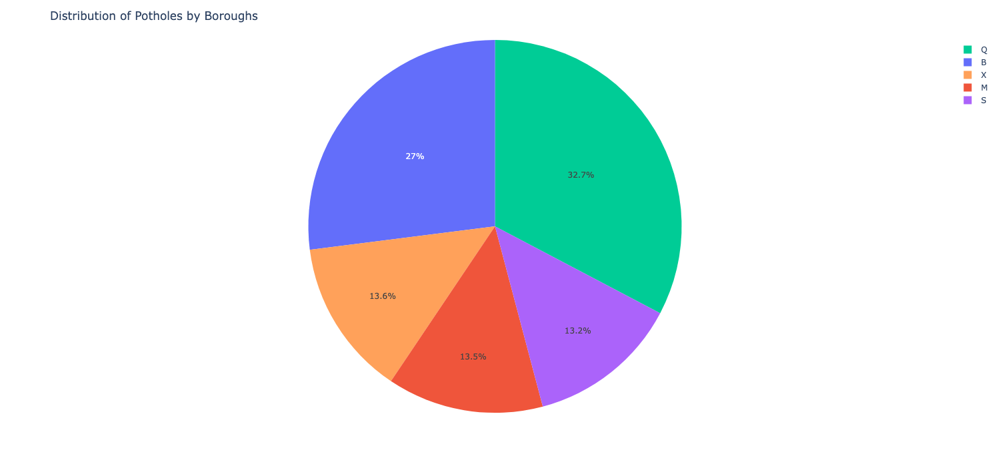

In [78]:
# Plot distribution of Number of Potholes by Boroughs of NYC

fig = px.pie(df, 
             values=df['index'].value_counts().values, 
             names='Boro', color='Boro')
fig.update_layout(title_text='Distribution of Potholes by Boroughs', height=700, width=700)

fig.show()

We can see that the most number of potholes occurences are in Queens and then Brooklyn. We can assume that number of potholes are dependent on the area of Boroughs.

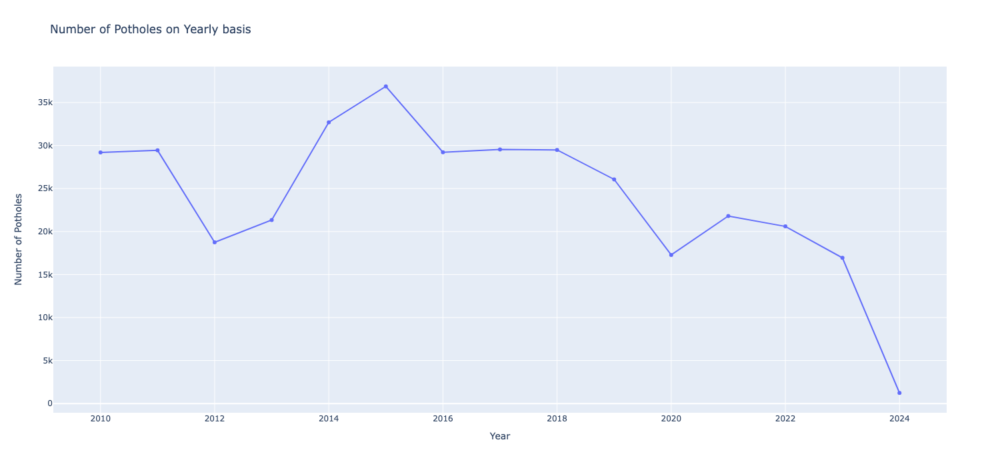

In [57]:
# Plot number of potholes on yearly basis
df['year'] = pd.to_datetime(df['RptDate'], format='%Y') #extracting year

# Group by year and count potholes
potholes_by_year = df.groupby(df['year'].dt.year).size().reset_index(name='potholes_count')

# Create a Plotly line plot
fig = px.line(potholes_by_year, x='year', y='potholes_count', markers=True, title='Number of Potholes on Yearly basis')
fig.update_layout(xaxis_title='Year', yaxis_title='Number of Potholes')
fig.update_layout(height=700)

# Show the plot
fig.show()

In [71]:
potholes_by_year.mean()

year               2017.000000
potholes_count    24031.933333
dtype: float64

The highest number of potholes recorded in NYC in a calendar year was 2015 with slightly over 36K potholes. Overall the yearly average is 24032 potholes per year.

In [72]:
# Days took to fix the pothole
date_diff = df['RptClosed'] -df['RptDate']
date_diff.mean()

#Average timeline for the pothole report to porthole fix is 4.5 days.

Timedelta('4 days 13:04:03.166453524')

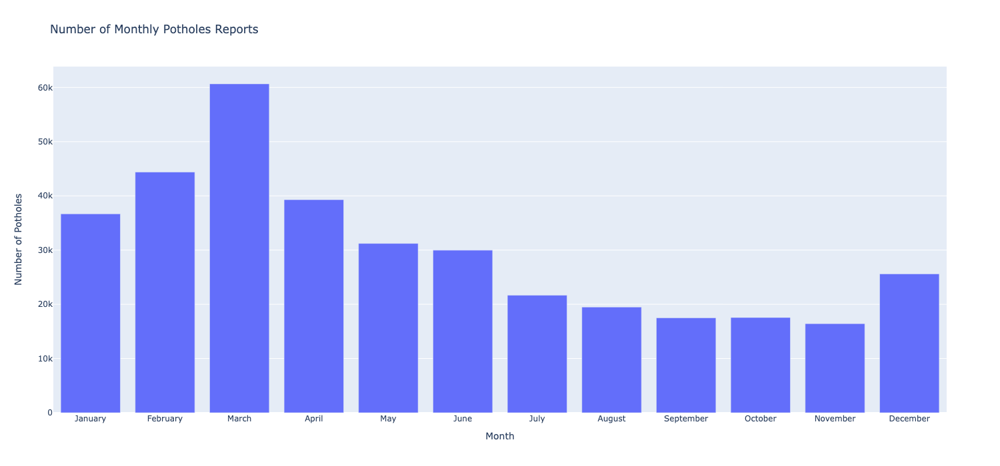

In [34]:
# months with most potholes

df['month'] = df['RptDate'].dt.month_name()

# Group by month and calculate the sum of potholes_count
monthly_potholes = df.groupby('month')['index'].count().reset_index()

# Create a Plotly bar chart
fig = px.bar(monthly_potholes, x='month', y='index', title='Number of Monthly Potholes Reports')

fig.update_layout(xaxis_title='Month', yaxis_title='Number of Potholes', height=700)

#plotly is not preserving monthly order so I have to pass the parameters to adjust the monthly order
month_order = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
fig.update_xaxes(categoryorder='array', categoryarray=month_order)


# Show the plot
fig.show()

The trend to note here is that the pothole numbers are maximum in the spring season which helped me to unveil an interesting fact that If the water freezes and thaws over and over, the pavement will weaken and continue cracking. 